# Twin Delayed Deep Deterministic Policy Gradient (TD3)

# Setup

In [ ]:
!pip install -U pybullet
!pip install -U matplotlib
!pip install -U numpy
!pip install -U gym
!pip install celluloid
!pip install gym-notebook-wrapper
!pip install --upgrade IPython
!pip install -I path.py==7.7.1
!sudo apt-get install xvfb
!pip install xvfbwrapper

  Using cached path.py-7.7.1-py2.py3-none-any.whl (28 kB)
Reading package lists... Done
Building dependency tree       
Reading state information... Done
xvfb is already the newest version (2:1.19.6-1ubuntu4.10).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.


# Imports

In [ ]:
from IPython.display import Video
from IPython.display import HTML
import celluloid
from copy import copy

In [ ]:

import torch
import torch.nn as nn
import torch.nn.functional as F

import gym
import gnwrapper
import os

import numpy as np
import matplotlib.pyplot as plt

import pybullet_envs
import pybullet


from time import sleep




In [ ]:
print("using ", "cuda" if torch.cuda.is_available() else "cpu")
print(torch.cuda.get_device_name(0))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

using  cuda
Tesla P100-PCIE-16GB


#Environments Discovery

## Random Agent

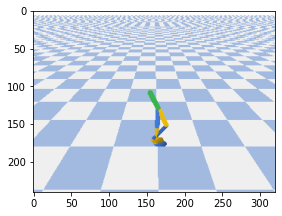

In [ ]:
#env = gnwrapper.LoopAnimation(gym.make("Walker2DBulletEnv-v0"))

demo_ENV = "Walker2DBulletEnv-v0"  

demo_env = gnwrapper.LoopAnimation(gym.make(demo_ENV))

obs = demo_env.reset()

for _ in range(10):
    next_obs, reward, done, info = demo_env.step(demo_env.action_space.sample())
    sleep(1./240.)
    demo_env.render()

    obs = next_obs
    if done:
        obs = demo_env.reset()
demo_env.display()


##Environment Infos

In [ ]:
demo_state_dim = demo_env.observation_space.shape[0]
demo_action_dim = demo_env.action_space.shape[0] 
demo_max_action = float(demo_env.action_space.high[0])
print('Observation Space:', demo_state_dim, 'Observations')
print('Action Space:',demo_action_dim, 'Actions')
print('Max Value in the action space:', demo_max_action)

Observation Space: 22 Observations
Action Space: 6 Actions
Max Value in the action space: 1.0


# Networks

In [ ]:
class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, max_action):
        super(Actor, self).__init__()

        self.fc1 = nn.Linear(state_dim, 400)
        self.fc2 = nn.Linear(400, 300)
        self.fc3 = nn.Linear(300, action_dim)
        
        self.max_action = max_action

    def forward(self, state):
        a = F.relu(self.fc1(state))
        a = F.relu(self.fc2(a))
        return self.max_action * torch.tanh(self.fc3(a))


In [ ]:
class Critic(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Critic, self).__init__()

        self.fc1 = nn.Linear(state_dim + action_dim, 400)
        self.fc2 = nn.Linear(400, 300)
        self.fc3 = nn.Linear(300, 1)

    def forward(self, state, action):
        state_action = torch.cat([state, action], 1)
        q = F.relu(self.fc1(state_action))
        q = F.relu(self.fc2(q))
        q = self.fc3(q)

        return q



# Memory

In [ ]:
class ReplayBuffer:
    # This is basically taken straight from TD3 original papers' code, it's just a ciruclar buffer on parallel arrays
    def __init__(self, state_dim, action_dim, max_size):
        self.max_size = max_size
        self.ptr = 0
        self.size = 0

        self.state = np.zeros((max_size, state_dim))
        self.action = np.zeros((max_size, action_dim))
        self.next_state = np.zeros((max_size, state_dim))
        self.reward = np.zeros((max_size, 1))
        self.done = np.zeros((max_size, 1))


    def add(self, state, action, next_state, reward, done):
        self.state[self.ptr] = state
        self.action[self.ptr] = action
        self.next_state[self.ptr] = next_state
        self.reward[self.ptr] = reward
        self.done[self.ptr] = done

        # essentially a circular buffer
        self.ptr = (self.ptr + 1) % self.max_size
        self.size = min(self.size + 1, self.max_size)


    def sample(self, batch_size):
        ind = np.random.randint(0, self.size, size=batch_size)

        return (
            torch.FloatTensor(self.state[ind]).to(device),
            torch.FloatTensor(self.action[ind]).to(device),
            torch.FloatTensor(self.next_state[ind]).to(device),
            torch.FloatTensor(self.reward[ind]).to(device),
            torch.FloatTensor(self.done[ind]).to(device)
        )
        



# Agent

In [ ]:
class TD3(object):
    # Adapted from both the paper and the git

    def __init__(
        self,
        state_dim,
        action_dim,
        max_action,
        discount=0.99,
        tau=0.005,
        policy_noise=0.2,
        noise_clip=0.5,
        policy_freq=2,
        lr=3e-4
    ):

        self.actor = Actor(state_dim, action_dim, max_action).to(device)
        self.actor_target = Actor(state_dim, action_dim, max_action).to(device)
        self.actor_optimizer = torch.optim.Adam(self.actor.parameters(), lr=lr)

        self.critic1 = Critic(state_dim, action_dim).to(device)
        self.critic1_target = Critic(state_dim, action_dim).to(device)
        self.critic1_optimizer = torch.optim.Adam(self.critic1.parameters(), lr=lr)

        self.critic2 = Critic(state_dim, action_dim).to(device)
        self.critic2_target = Critic(state_dim, action_dim).to(device)
        self.critic2_optimizer = torch.optim.Adam(self.critic2.parameters(), lr=lr)


        self.max_action = max_action
        self.discount = discount
        self.tau = tau
        self.policy_noise = policy_noise
        self.noise_clip = noise_clip
        self.policy_freq = policy_freq

        self.total_it = 0


    def select_action(self, state):
        state = torch.FloatTensor(state.reshape(1, -1)).to(device)
        return self.actor(state).cpu().data.numpy().flatten()


    def train(self, replay_buffer, batch_size=256):
        self.total_it += 1

        ret_actor_loss = None

        # Sample replay buffer 
        state, action, next_state, reward, done = replay_buffer.sample(batch_size)

        with torch.no_grad():
            # Select action according to policy and add clipped noise
            noise = (
                torch.randn_like(action) * self.policy_noise
            ).clamp(-self.noise_clip, self.noise_clip)
            
            next_action = (
                self.actor_target(next_state) + noise
            ).clamp(-self.max_action, self.max_action)

            # Compute the target Q value
            target_Q1 = self.critic1_target(next_state, next_action)
            target_Q2 = self.critic2_target(next_state, next_action)
            target_Q = torch.min(target_Q1, target_Q2)
            target_Q = reward + (1-done) * self.discount * target_Q

        # Get current Q estimates
        current_Q1 = self.critic1(state, action)
        current_Q2 = self.critic2(state, action)
        
        # Compute critics loss
        critic1_loss = F.mse_loss(current_Q1, target_Q)
        critic2_loss = F.mse_loss(current_Q2, target_Q)
        ret_critics_loss = critic1_loss.item() + critic2_loss.item()

        # Optimize the critics
        self.critic1_optimizer.zero_grad()
        critic1_loss.backward()
        self.critic1_optimizer.step()

        self.critic2_optimizer.zero_grad()
        critic2_loss.backward()
        self.critic2_optimizer.step()

        # Delayed policy updates
        if self.total_it % self.policy_freq == 0:

            # Compute actor loss
            actor_loss = -self.critic1(state, self.actor(state)).mean()
            ret_actor_loss = actor_loss.item()
            # Optimize the actor 
            self.actor_optimizer.zero_grad()
            actor_loss.backward()
            self.actor_optimizer.step()

            # Update the frozen target models
            for param, target_param in zip(self.critic1.parameters(), self.critic1_target.parameters()):
                target_param.data.copy_(self.tau * param.data + (1 - self.tau) * target_param.data)

            for param, target_param in zip(self.critic2.parameters(), self.critic2_target.parameters()):
                target_param.data.copy_(self.tau * param.data + (1 - self.tau) * target_param.data)

            for param, target_param in zip(self.actor.parameters(), self.actor_target.parameters()):
                target_param.data.copy_(self.tau * param.data + (1 - self.tau) * target_param.data)

        
        return ret_actor_loss, ret_critics_loss


    def save(self, filename):
        # Saving everything (otherwise the training on load is buggy)
        torch.save(self.critic1.state_dict(), filename + "_critic1")
        torch.save(self.critic1_target.state_dict(), filename + "_critic1_target")
        torch.save(self.critic1_optimizer.state_dict(), filename + "_critic1_optimizer")
        
        torch.save(self.critic2.state_dict(), filename + "_critic2")
        torch.save(self.critic2_target.state_dict(), filename + "_critic2_target")
        torch.save(self.critic2_optimizer.state_dict(), filename + "_critic2_optimizer")
        
        torch.save(self.actor.state_dict(), filename + "_actor")
        torch.save(self.actor_target.state_dict(), filename + "_actor_target")
        torch.save(self.actor_optimizer.state_dict(), filename + "_actor_optimizer")


    def load(self, filename):
        self.critic1.load_state_dict(torch.load(filename + "_critic1"))
        self.critic1_target.load_state_dict(torch.load(filename + "_critic1_target"))
        self.critic1_optimizer.load_state_dict(torch.load(filename + "_critic1_optimizer"))

        self.critic2.load_state_dict(torch.load(filename + "_critic2"))
        self.critic2_target.load_state_dict(torch.load(filename + "_critic2_target"))
        self.critic2_optimizer.load_state_dict(torch.load(filename + "_critic2_optimizer"))

        self.actor.load_state_dict(torch.load(filename + "_actor"))
        self.actor_target.load_state_dict(torch.load(filename + "_actor_target"))
        self.actor_optimizer.load_state_dict(torch.load(filename + "_actor_optimizer"))
        


# Evaluate

In [ ]:

# Runs policy for X episodes and returns average reward
# A fixed seed is used for the eval environment
def eval_policy(policy, env_name, seed, eval_episodes, shake_weight, drift_weight):
    if env_name == "Walker2DBulletEnv-v0":
        eval_env = gnwrapper.LoopAnimation(gym.make(env_name))
    else:
        eval_env = gnwrapper.LoopAnimation(gym.make(env_name, shake_weight=shake_weight, drift_weight=drift_weight))
    eval_env.seed(seed + 100)

    avg_reward = 0.
    for _ in range(eval_episodes):
        state, done = eval_env.reset(), False
        while not done:
            action = policy.select_action(np.array(state))
            state, reward, done, _ = eval_env.step(action)
            #env.render()
            avg_reward += reward

    avg_reward /= eval_episodes

    print("---------------------------------------")
    print(f"Evaluation over {eval_episodes} episodes: {avg_reward:.3f}")
    print("---------------------------------------")

    eval_env.close()

    return avg_reward

def test_agent(policy, env):
    test_env = env
    test_reward = 0.
    r=0
  
    state, done = test_env.reset(), False
    test_env.render()
    while not done :
        r += 1
        action = policy.select_action(np.array(state))
        sleep(1./240.)

        state, reward, done, _ = test_env.step(action)
        if 10<r<150: # to satisfy memory constraint of github files, We sample juste 100 time step to display
          test_env.render()
            
        test_reward += reward

    
    print("---------------------------------------")
    print(f"Test reward over the episode: {test_reward:.3f}")
    print("---------------------------------------")

    test_env.display()


# Config

In [ ]:

ENV = "Walker2DBulletEnv-v0"          # gym environment name (only MinitaurBulletEnv-v0 and Walker2DBulletEnv-v0
seed =  4                            # Sets Gym, PyTorch and Numpy seeds
start_timesteps = 25e3              # Time steps initial random policy is used
eval_freq = 25e3                   # How often (time steps we evaluate
max_timesteps = 3e5                # Max time steps to run environment
expl_noise = 0.1                    # Std of Gaussian exploration noise
batch_size = 256                    # Batch size for both actor and critic
discount = 0.99                 # Discount factor
tau = 0.005                     # Target network update rate
policy_noise = 0.2              # Noise added to target policy during critic update
noise_clip = 0.5                # Range to clip target policy noise
policy_freq = 2       # Frequency of delayed policy updates
learning_rate = 3e-4            # Learning rate for the critics and actor
shake_weight = 0.2              # (minitaur only control the penality caused by the robot shaking
drift_weight = 0.1              # (minitaur only control the penality caused by the robot not staying on course
render = "store_true"            # render the training (it doesn't affect the learning speed
save_model = "store_true"        # Save model and optimizer parameters
load_model = ""                 # Model load file name, "" doesn't load, "default" uses file_name
testing = "store_true"  



# Main

In [ ]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

file_name = f"{ENV}_Agent_seed_{seed}"

if save_model and not os.path.exists(f"./saved_models/{file_name}"):
  os.makedirs(f"./saved_models/{file_name}")

if ENV == "Walker2DBulletEnv-v0":
  env = gnwrapper.LoopAnimation(gym.make(ENV))
else:
  env = gnwrapper.LoopAnimation(gym.make(ENV, render=render, shake_weight=shake_weight, drift_weight=drift_weight))

# Set seeds
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

state_dim = env.observation_space.shape[0]
action_dim = env.action_space.shape[0] 
max_action = float(env.action_space.high[0])
print('Observation Space:', state_dim, 'Observations')
print('Action Space:',action_dim, 'Actions')
print('Max Value in the action space:', max_action)



kwargs = {
        "state_dim": state_dim,
        "action_dim": action_dim,
        "max_action": max_action,
        "discount": discount,
        "tau": tau,
        "lr": learning_rate,
        "policy_noise": policy_noise * max_action,
        "noise_clip": noise_clip * max_action,
        "policy_freq": policy_freq,
    }

policy = TD3(**kwargs)



    
replay_buffer = ReplayBuffer(state_dim, action_dim, max_size=int(1e5)) # larger buffers are good, to a point



Observation Space: 22 Observations
Action Space: 6 Actions
Max Value in the action space: 1.0


##Initialization

In [ ]:
# for plotting
y = [eval_policy(policy, ENV, seed, 10, shake_weight, drift_weight)] # cumul timesteps
x = [0] # cumul timesteps
train_reward = [] # per episode
train_timesteps = [] # per episode
train_actor_loss = [] # per episode
train_critics_loss = [] # per episode




---------------------------------------
Evaluation over 10 episodes: 30.404
---------------------------------------


In [ ]:
state = env.reset()


In [ ]:
episode_reward = 0
episode_timesteps = 0
episode_num = 0
episode_actor_loss = 0.0
episode_critics_loss = 0.0

# Train

In [ ]:

for t in range(int(max_timesteps)):
        
    episode_timesteps += 1

        # Select action randomly for the first start_timesteps (to load some data in the replay buffer)
    if t < start_timesteps:
        action = env.action_space.sample()
        #state, _, _, _ = env.step(action) 
    else:
            # Add some random noise to the selected actions (for exploration)
        action = (
            policy.select_action(np.array(state))
            + np.random.normal(0, max_action * expl_noise, size=action_dim)
        ).clip(-max_action, max_action)

        # Perform action
    next_state, reward, done, _ = env.step(action)
    
    # to satisfy memory constraint of github files, We sample juste few time step to display
    # So we will sample just some stages:
    # 1st stage: 100 timestep before timestep 100 000
    # 2nd stage: 100 timestep before timestep 200 000
    # 3rd stage: 100 timestep before timestep 300 000

    if t % 100000 >= 99900: 
      env.render()

        
        # This is env specific, but for our purpose env._max_episode_steps is 1000
        # we don't want to flag the step as an ending step if it was stopped by going over the limit
    if episode_timesteps < env.spec.max_episode_steps:
      done_bool = float(done)  
    else:
      done_bool = 0.0

        # Store data in replay buffer
    replay_buffer.add(state, action, next_state, reward, done_bool)

    state = next_state
    episode_reward += reward

        # Now we can train
    if t >= start_timesteps:
        actor_loss, critics_loss = policy.train(replay_buffer, batch_size)
        if actor_loss:
            episode_actor_loss += actor_loss
        episode_critics_loss += critics_loss

    if done: 
        train_reward.append(episode_reward)
        train_timesteps.append(episode_timesteps)
        train_actor_loss.append(episode_actor_loss/episode_timesteps)
        train_critics_loss.append(episode_critics_loss/episode_timesteps)
        if episode_num % 10 == 0:         
          print(f"cumulated timesteps: {t+1} Episode: {episode_num+1} timesteps: {episode_timesteps} reward: {episode_reward:.3f}")
        # Reset environment
        state, done = env.reset(), False
        episode_reward = 0
        episode_timesteps = 0
        episode_actor_loss = 0.0
        episode_critics_loss = 0.0
        episode_num += 1 
            
    if (t + 1) % eval_freq == 0:


        y.append(eval_policy(policy, ENV, seed, 10, shake_weight, drift_weight))
        x.append(t)
        
        

policy.save(f"./saved_models/{file_name}/{file_name}")
        






cumulated timesteps: 14 Episode: 1 timesteps: 14 reward: 15.163
cumulated timesteps: 158 Episode: 11 timesteps: 8 reward: 11.866
cumulated timesteps: 312 Episode: 21 timesteps: 11 reward: 15.135
cumulated timesteps: 454 Episode: 31 timesteps: 9 reward: 14.644
cumulated timesteps: 589 Episode: 41 timesteps: 17 reward: 19.982
cumulated timesteps: 721 Episode: 51 timesteps: 10 reward: 14.433
cumulated timesteps: 843 Episode: 61 timesteps: 13 reward: 14.526
cumulated timesteps: 993 Episode: 71 timesteps: 13 reward: 16.123
cumulated timesteps: 1152 Episode: 81 timesteps: 16 reward: 18.754
cumulated timesteps: 1290 Episode: 91 timesteps: 8 reward: 13.419
cumulated timesteps: 1446 Episode: 101 timesteps: 12 reward: 16.677
cumulated timesteps: 1601 Episode: 111 timesteps: 16 reward: 20.013
cumulated timesteps: 1744 Episode: 121 timesteps: 18 reward: 19.850
cumulated timesteps: 1881 Episode: 131 timesteps: 14 reward: 14.894
cumulated timesteps: 2050 Episode: 141 timesteps: 12 reward: 13.563
cum

## Training plots

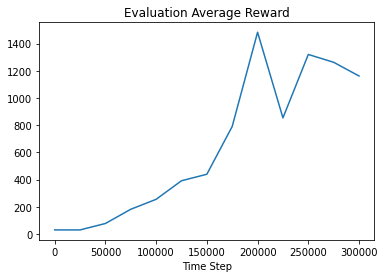

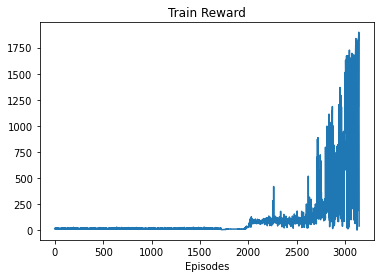

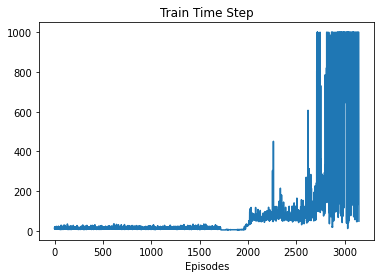

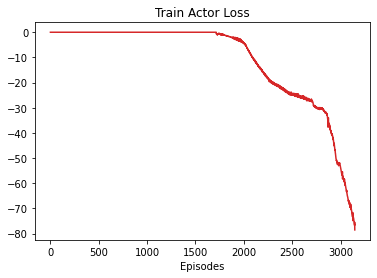

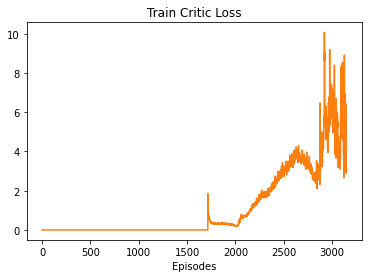

In [ ]:
fig1, ax1 = plt.subplots()
ax1.plot(x, y)
ax1.set_xlabel('Time Step')
ax1.set_title('Evaluation Average Reward')
plt.savefig(f"./saved_models/{file_name}/eval_avg_reward.png")
#plt.close(fig1)

fig2, ax2 = plt.subplots()
ax2.plot(list(range(0,len(train_reward))), train_reward)
ax2.set_xlabel('Episodes')
ax2.set_title('Train Reward')
plt.savefig(f"./saved_models/{file_name}/train_reward.png")
#plt.close(fig2)

fig3, ax3 = plt.subplots()
ax3.set_xlabel('Episodes')
ax3.set_title('Train Time Step')        
ax3.plot(list(range(0,len(train_timesteps))), train_timesteps)
plt.savefig(f"./saved_models/{file_name}/train_timesteps.png")
#plt.close(fig3)

fig4, ax4 = plt.subplots()
ax4.set_xlabel('Episodes')
ax4.set_title('Train Actor Loss')        
ax4.plot(list(range(0,len(train_actor_loss))), train_actor_loss, color='tab:red')
plt.savefig(f"./saved_models/{file_name}/train_actor_loss.png")
#plt.close(fig4)

fig5, ax5 = plt.subplots()
ax5.set_xlabel('Episodes')
ax5.set_title('Train Critic Loss')        
ax5.plot(list(range(0,len(train_critics_loss))), train_critics_loss, color='tab:orange')
plt.savefig(f"./saved_models/{file_name}/train_critics_loss.png")
#plt.close(fig5)

##Training Display 

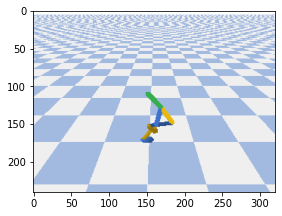

In [ ]:

#Display the training progression
    # to satisfy memory constraint of github files, We sample juste few time step to display
    # So we will sample just some stages:
    # 1st stage: 100 timestep before timestep 100 000
    # 2nd stage: 100 timestep before timestep 200 000
    # 3rd stage: 100 timestep before timestep 300 000
env.display()

#Testing

---------------------------------------
Test reward over the episode: 1914.417
---------------------------------------


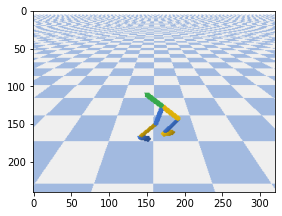

In [ ]:
env_test = gnwrapper.LoopAnimation(gym.make("Walker2DBulletEnv-v0"))

policy.load("/content/saved_models/Walker2DBulletEnv-v0_Agent_seed_4/Walker2DBulletEnv-v0_Agent_seed_4")    

test_agent(policy, env_test)
